In [5]:
import os, sys
import pandas as pd

from src import settings
from src.utils import fileio

TREATMENT = "OCT_5DIZ"
INPUT_DIR = os.path.join(settings.OUTPUT_DIR, "1_0_find_interactions", TREATMENT)

treatment = fileio.load_files_from_folder(INPUT_DIR)
for group_name, group_path in treatment.items():
    df_interactions = pd.read_csv(group_path, index_col=0)
    sys.exit()

SystemExit: 

/home/milky/drosophila-SNA/.env/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3516: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [11]:
import pandas as pd 
group_path = r"../../data/processed/1_0_find_interactions/OCT_5DIZ/OCT_5DIZ_A1_11_09_2023-10_54.csv"

df_interactions = pd.read_csv(group_path, index_col=0)
# df_interactions = df_interactions.sort_values("start_of_interaction")
df_interactions.head(30)

,node_1,node_2,start_of_interaction,end_of_interaction,duration
0,fly17,fly19,783,822,40
1,fly17,fly19,5690,5703,14
2,fly17,fly19,12922,12941,20
3,fly17,fly19,23119,23140,22
4,fly17,fly13,7371,7386,16
5,fly17,fly13,9121,9133,13
6,fly17,fly13,9610,9624,15
7,fly17,fly13,13922,13941,20
8,fly17,fly13,15339,15355,17
9,fly17,fly13,23578,23589,12


CsCh_A1_25_05_2023-12_44


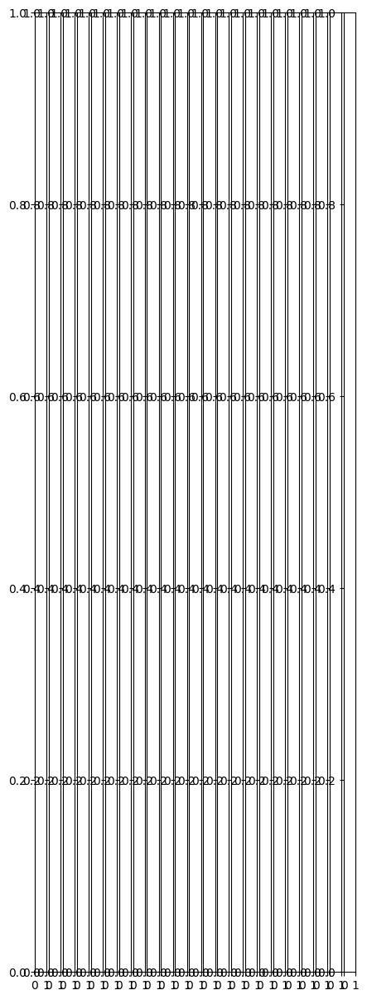

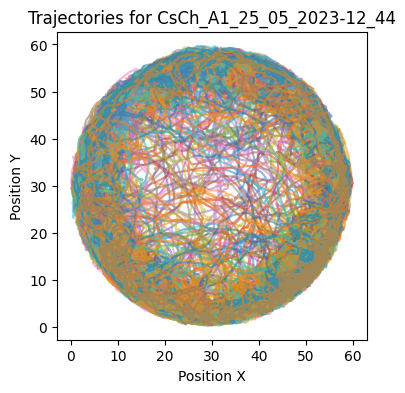

CsCh_A1_21_04_2023-11_54


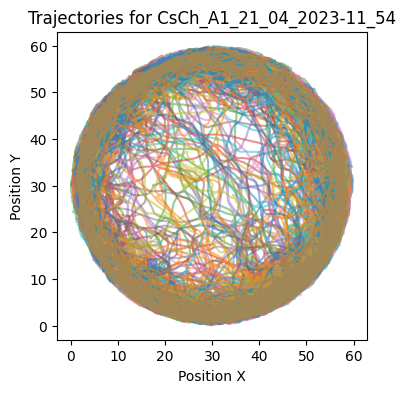

CsCh_A4_21_04_2023-11_08


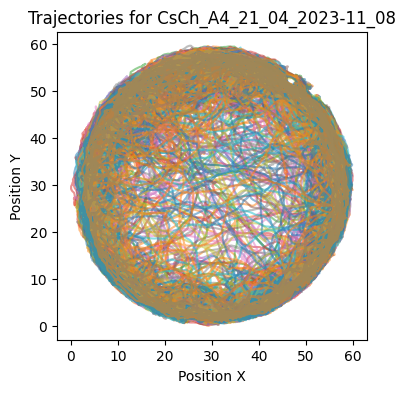

CsCh_A1_24_05_2023-12_27


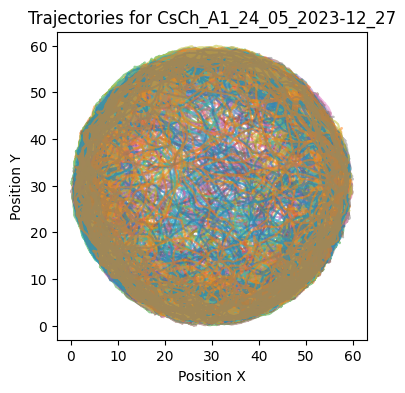

CsCh_A4_28_04_2023-11_20


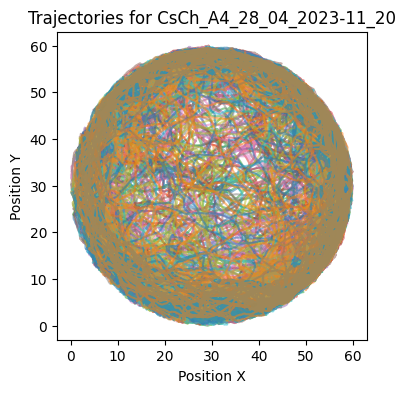

CsCh_A2_24_05_2023-11_32


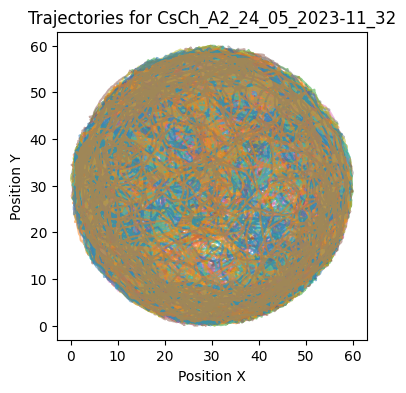

CsCh_A3_25_05_2023-12_44


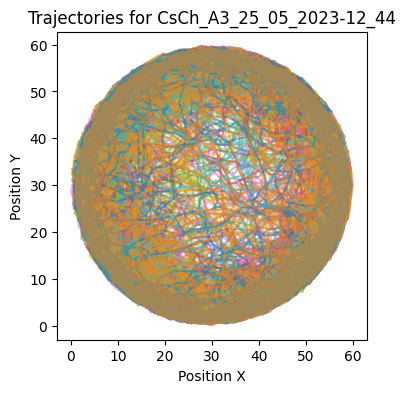

CsCh_A4_24_05_2023-12_27


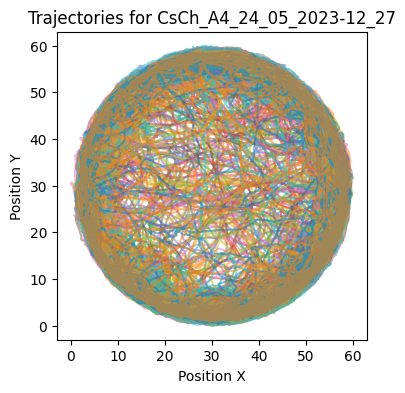

CsCh_A3_24_05_2023-12_27


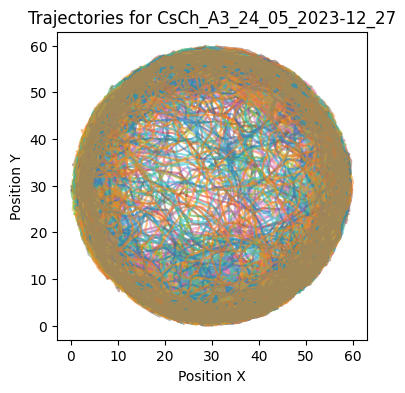

CsCh_A3_21_04_2023-11_08


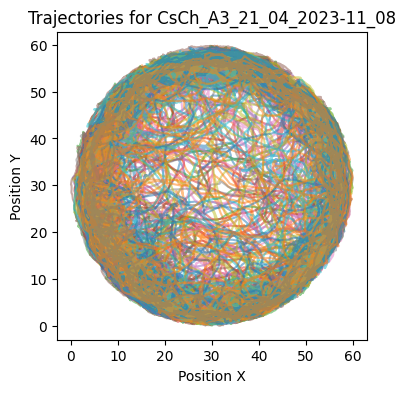

CsCh_A1_24_05_2023-11_32


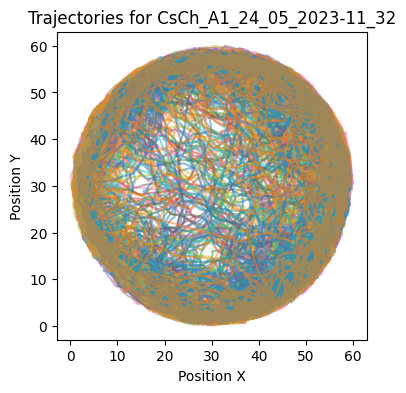

CsCh_A2_20_06_2023-12_05


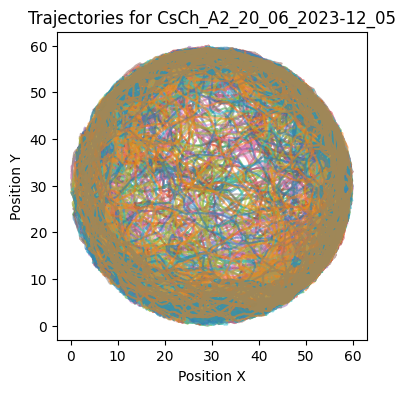

CsCh_A2_25_05_2023-12_44


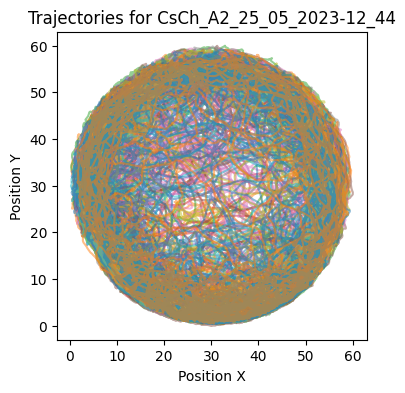

CsCh_A1_20_06_2023-12_05


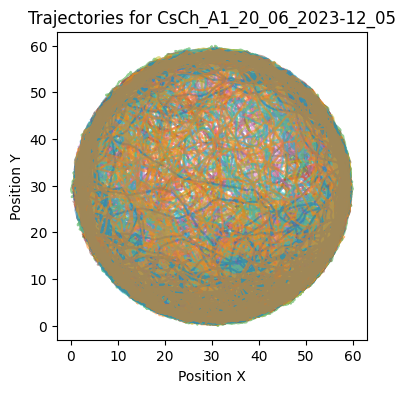

CsCh_A3_28_04_2023-11_20


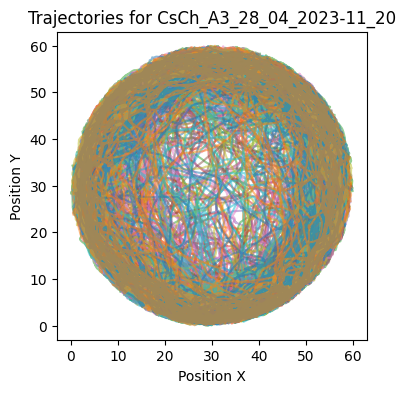

CsCh_A2_20_04_2023-11_45


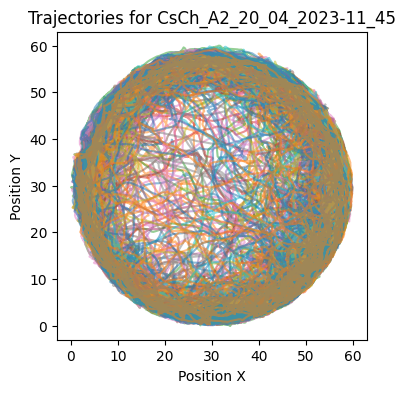

CsCh_A2_28_04_2023-11_20


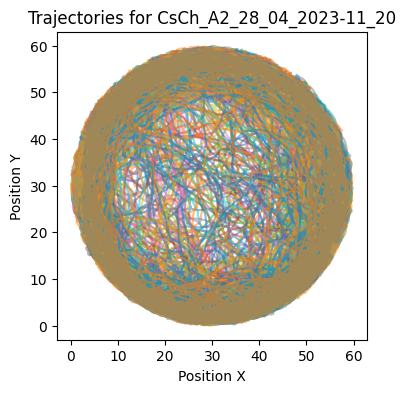

CsCh_A3_24_05_2023-11_32


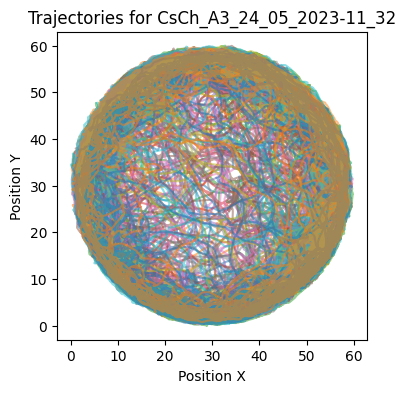

CsCh_A4_25_05_2023-12_44


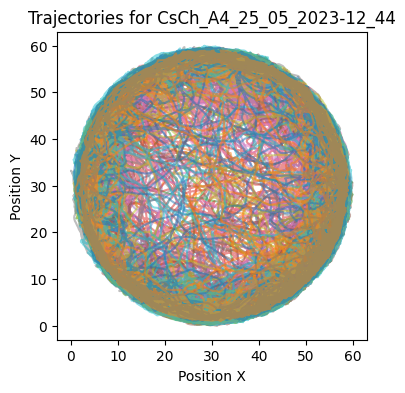

CsCh_A2_19_04_2023-12_08


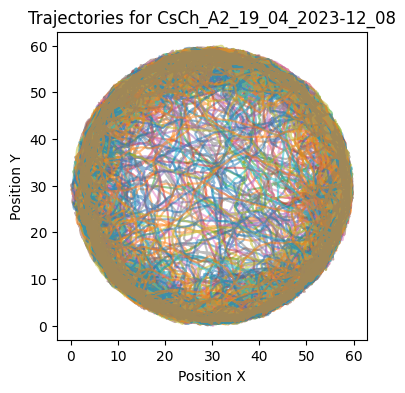

CsCh_A3_20_04_2023-11_45


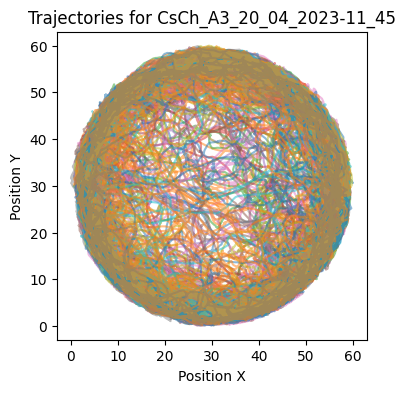

CsCh_A1_05_05_2023-11_21


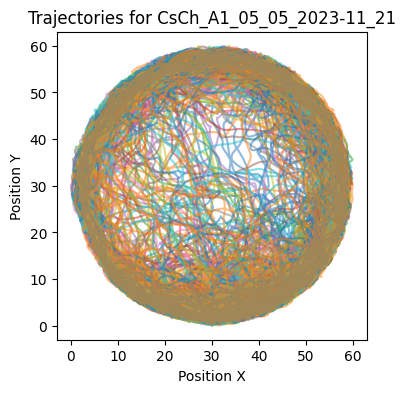

CsCh_A4_21_04_2023-11_54


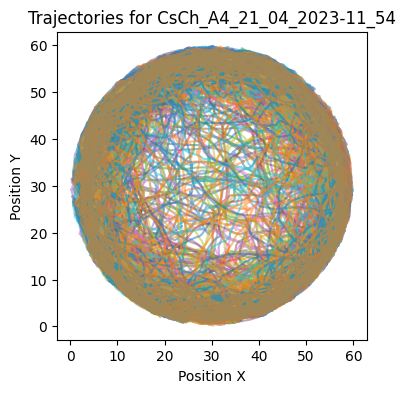

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt

import os
os.environ['OPENBLAS_NUM_THREADS'] = '1'
import pandas as pd

parent_folder  = r"/home/milky/drosophila-SNA/data/processed/0_0_preproc_data/CsCh/"

treatment_folders = [folder for folder in os.listdir(parent_folder) if os.path.isdir(os.path.join(parent_folder, folder))]
fig, axs = plt.subplots(1, len(treatment_folders), figsize=(5, 15))

for folder in treatment_folders:
    print(folder)
    treatment_folder_path = os.path.join(parent_folder, folder)
    
    # List all CSV files in the treatment folder
    csv_files = [file for file in os.listdir(treatment_folder_path) if file.endswith('.csv')]
    
    fig, ax = plt.subplots(figsize=(4, 4))
    # Loop through each CSV file and plot the trajectories in the current treatment's plot
    for csv_file in csv_files:
        csv_file_path = os.path.join(treatment_folder_path, csv_file)
        
        # Read the CSV file into a DataFrame
        df = pd.read_csv(csv_file_path)
        
        # Plot the trajectory from the DataFrame with opacity
        ax.plot(df["pos x"], df["pos y"], label=csv_file, alpha=0.5)
    
    # Set labels and title for the plot
    ax.set_xlabel("Position X")
    ax.set_ylabel("Position Y")
    ax.set_title(f"Trajectories for {folder}")
    # ax.legend(loc='best')
    
    # Show the current treatment's plot
    plt.show()

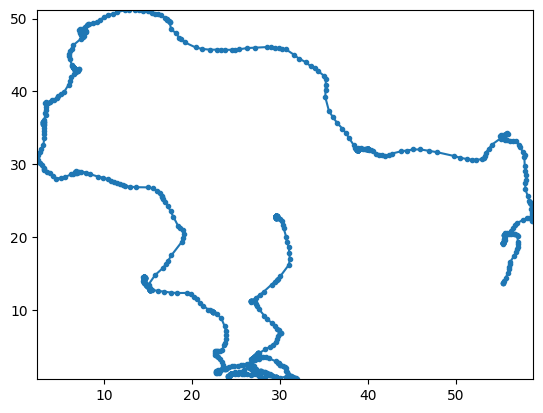

In [19]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# df = df.tail(1500)
# Create a figure and axis
fig, ax = plt.subplots()
ax.set_xlim(df['pos x'].min(), df['pos x'].max())
ax.set_ylim(df['pos y'].min(), df['pos y'].max())

# Initialize an empty line
line, = ax.plot([], [], marker='.', linestyle='-')

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to update the plot for each frame
def update(frame):
    x = df['pos x'][:frame]
    y = df['pos y'][:frame]
    line.set_data(x, y)
    return line,

# Create the animation
ani = FuncAnimation(fig, update, frames=len(df), init_func=init, blit=True)

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())

In [40]:
"LDA_5DIZ_A1_01_08_2023-12_10"
"434,481,48"

fly10 = "/home/milky/drosophila-SNA/data/processed/0_0_preproc_data/LDA_5DIZ/LDA_5DIZ_A1_01_08_2023-12_10/fly10.csv"
fly5 = "/home/milky/drosophila-SNA/data/processed/0_0_preproc_data/LDA_5DIZ/LDA_5DIZ_A1_01_08_2023-12_10/fly5.csv"

df_fly10 = pd.read_csv(fly10)
df_fly5 = pd.read_csv(fly5)

df_fly10 = df_fly10[434:481]
df_fly5 = df_fly5[434:481]

df_fly10 = df_fly10[["pos x", "pos y"]]
df_fly5 = df_fly5[["pos x", "pos y"]]

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt


csv_directory  = "/home/milky/drosophila-SNA/data/processed/0_0_preproc_data/CsCh/CsCh_A4_28_04_2023-11_20"

dataframes = []
file_names = []

# Iterate over each CSV file in the directory
for file_name in os.listdir(csv_directory):
    if file_name.endswith(".csv"):
        file_path = os.path.join(csv_directory, file_name)
        
        # Read the CSV file into a Pandas dataframe
        df = pd.read_csv(file_path)
        df = df.head(2)
        
        # Append the dataframe and file name to the respective lists
        dataframes.append(df)
        file_names.append(file_name)

# Create a Matplotlib figure and axis
fig, ax = plt.subplots()

# Iterate through dataframes and file names to plot data
for df, name in zip(dataframes, file_names):
    ax.plot(df['pos x'], df['pos y'], label=name)

# Set labels and title
ax.set_xlabel('Position X')
ax.set_ylabel('Position Y')
ax.set_title('CSV Data Plots')

# Show the legend
ax.legend()

# Show the plot
plt.show()
